In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import cellrank as cr
import scvelo as scv
from anndata import AnnData
from pathlib import Path
import matplotlib.pyplot as plt
import session_info

/tmp/ipykernel_3947/2983784523.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
sc.set_figure_params(dpi_save=400)

In [3]:
home = Path("../data/")

In [4]:
dorc_path = "../archr/ArchROutput/p2g/p2g_500Kbp_all_dorc_thresh10.tsv"
rna_proc_path = "hplacenta_gene_matrix_velo.h5ad"
atac_path = '../archr/ArchROutput/filtered_peak_bc_matrix/hplacenta_peak_matrix.h5ad'

In [5]:
dorcs = pd.read_csv(dorc_path, index_col=0, sep='\t')
dorcs

,HES4,MMP23B,PRKCZ,GPR153,GPR157,SPSB1,TNFRSF1B,AADACL3,C1orf158,PDPN,...,EGFL7,TMSB4X,EGFL6,MIR222HG,MSN,OPHN1,SRPX2,TSC22D3,AMOT,VGLL1
JS34#ACGTCAAGTTGCAATG-1,185.543793,289.912170,162.350830,289.912170,81.175415,452.263062,115.964882,0.000000,0.000000,313.105164,...,104.368393,104.368393,382.684113,185.543808,115.964882,0.000000,46.385952,57.982437,0.000000,0.000000
JS34#TGTTGGCCAAGGTACG-1,163.067993,172.660233,239.805862,38.368938,134.291275,153.475754,47.961174,76.737877,57.553406,0.000000,...,95.922340,38.368938,38.368938,19.184469,9.592235,182.252457,0.000000,67.145645,67.145645,115.106812
JS34#TTTGCGACAGTACCGT-1,161.838501,118.681564,323.677002,43.156937,172.627747,140.260040,43.156937,107.892342,86.313866,10.789234,...,107.892342,43.156937,43.156937,53.946171,0.000000,21.578468,0.000000,118.681580,43.156937,43.156937
JS34#AACCTTGCACATAGCC-1,77.012672,154.025360,317.677307,48.132919,134.772171,202.158264,86.639259,96.265839,57.759506,19.253168,...,38.506336,38.506336,48.132919,38.506336,0.000000,192.531677,0.000000,96.265839,77.012672,96.265839
JS34#AGAGAGGAGGTGTCCA-1,164.486313,142.554810,54.828773,76.760284,142.554810,164.486313,230.280838,0.000000,0.000000,0.000000,...,581.185059,87.726036,43.863018,109.657547,109.657547,43.863018,65.794525,54.828773,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
JS36#CATGGATTCCAAGTGT-1,594.353699,594.353699,0.000000,594.353699,0.000000,0.000000,594.353699,0.000000,0.000000,1188.707397,...,594.353699,594.353699,0.000000,594.353699,0.000000,0.000000,297.176849,0.000000,0.000000,0.000000
JS36#CGCACAATCATAACTG-1,0.000000,0.000000,1264.622070,0.000000,632.311035,0.000000,0.000000,0.000000,0.000000,0.000000,...,316.155518,0.000000,0.000000,0.000000,0.000000,632.311035,0.000000,0.000000,0.000000,0.000000
JS36#GCTAGCCAGACCATAC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
JS36#CCAAACTAGTTTGGGT-1,0.000000,597.907410,896.861084,0.000000,0.000000,597.907410,597.907410,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [6]:
adata = sc.read(rna_proc_path)

In [7]:
adata_atac = sc.read(atac_path)

adata

AnnData object with n_obs × n_vars = 36456 × 36546
    obs: 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Gex_nUMI', 'Gex_nGenes', 'Gex_MitoRatio', 'Gex_RiboRatio', 'DoubletScore', 'DoubletEnrichment', 'gest_week', 'Clusters', 'ReadsInPeaks', 'FRIP', 'n_counts'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr'
    uns: 'neighbors', 'pca'
    obsm: 'X_lsi', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'ambiguous', 'matrix', 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

In [8]:
np.unique(adata.obs.Clusters)

array(['EVT1', 'EVT2', 'EVT3', 'Endothelial_cells', 'Fibroblast1',
       'Fibroblast2', 'Hofbauer cells', 'STB', 'maternal macrophages ',
       'myeloid_unknown', 'unknown1', 'unknown2', 'unknown3', 'vCTB1',
       'vCTB2', 'vCTB3', 'vCTBp'], dtype=object)

In [9]:
dorc_genes = list(pd.read_excel('../archr/DORC Genes.xlsx', header=None)[0])
dorc_genes.extend(['FOXF1', 'KANK1', 'FOXI3', 'VGLL3', 'PARD6B', 'TBX5'])
dorc_genes = list(set(dorc_genes))
dorc_obs = [g+'_dorc' for g in dorc_genes]
dorc_genes

['FOXF1',
 'C12orf75',
 'ATP11A',
 'RUNX1',
 'GRHL1',
 'IRX2',
 'PLXNB2',
 'KANK1',
 'TCF21',
 'SNAI2',
 'EGFR',
 'HLA-G',
 'VGLL3',
 'FOXI3',
 'PITX1',
 'FLI1',
 'DIO2',
 'PECAM1',
 'KLF6',
 'RTL1',
 'QSOX1',
 'TBX5',
 'ANXA1',
 'TFAP2C',
 'COL6A3',
 'MYCN',
 'ASCL2',
 'CYP19A1',
 'PARD6B',
 'RASGRF2',
 'NFIX',
 'MEG3',
 'MEG8',
 'JAK1',
 'DLK1',
 'NR2F6',
 'CXCL14']

In [10]:
adata.obs[dorc_obs] = dorcs[dorc_genes]

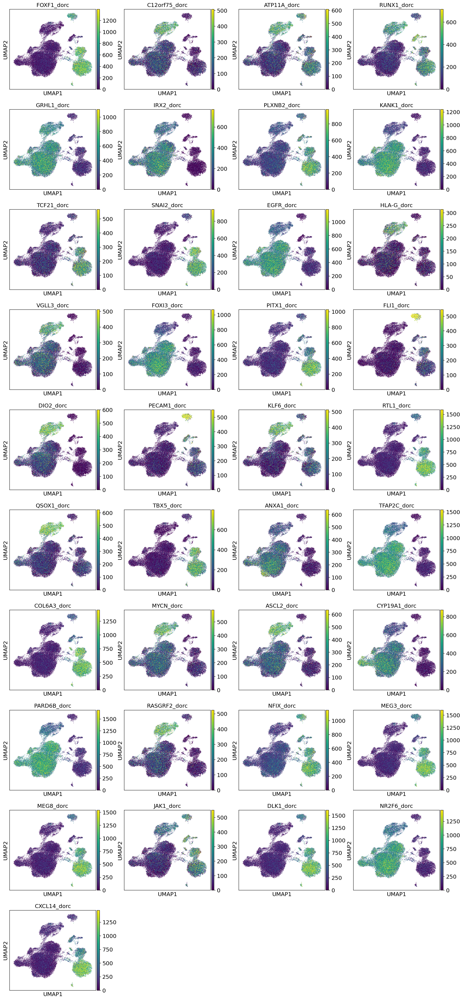

In [11]:
sc.pl.umap(adata, color=dorc_obs, save='_umap_dorc_score.pdf', vmin='p1', vmax='p99')

In [12]:
'''only Trophos'''
mask = (adata.obs.Clusters == 'EVT1') | (adata.obs.Clusters == 'EVT2') | (adata.obs.Clusters == 'EVT3') | \
(adata.obs.Clusters == 'vCTB1') | (adata.obs.Clusters == 'vCTB2') | (adata.obs.Clusters == 'vCTB3') | \
(adata.obs.Clusters == 'STB') | (adata.obs.Clusters == 'vCTBp')

adata_tro = adata[mask, :]
adata_atac_tro = adata_atac[mask,:]

print(np.unique(adata_tro.obs.Clusters))

scv.pp.neighbors(adata_tro)
scv.pp.moments(adata_tro, n_pcs=30, n_neighbors=30)

['EVT1' 'EVT2' 'EVT3' 'STB' 'vCTB1' 'vCTB2' 'vCTB3' 'vCTBp']
computing neighbors


/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/preprocessing/neighbors.py:96: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["neighbors"] = {}


    finished (0:00:37) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:30) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [16]:
# subset
adata = adata[dorcs.index.intersection(adata.obs_names), \
dorcs.columns.intersection(adata.var_names)].copy()
adata

/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


AnnData object with n_obs × n_vars = 36456 × 1057
    obs: 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Gex_nUMI', 'Gex_nGenes', 'Gex_MitoRatio', 'Gex_RiboRatio', 'DoubletScore', 'DoubletEnrichment', 'gest_week', 'Clusters', 'ReadsInPeaks', 'FRIP', 'n_counts', 'FOXF1_dorc', 'C12orf75_dorc', 'ATP11A_dorc', 'RUNX1_dorc', 'GRHL1_dorc', 'IRX2_dorc', 'PLXNB2_dorc', 'KANK1_dorc', 'TCF21_dorc', 'SNAI2_dorc', 'EGFR_dorc', 'HLA-G_dorc', 'VGLL3_dorc', 'FOXI3_dorc', 'PITX1_dorc', 'FLI1_dorc', 'DIO2_dorc', 'PECAM1_dorc', 'KLF6_dorc', 'RTL1_dorc', 'QSOX1_dorc', 'TBX5_dorc', 'ANXA1_dorc', 'TFAP2C_dorc', 'COL6A3_dorc', 'MYCN_dorc', 'ASCL2_dorc', 'CYP19A1_dorc', 'PARD6B_dorc', 'RASGRF2_dorc', 'NFIX_dorc', 'MEG3_dorc', 'MEG8_dorc', 'JAK1_dorc', 'DLK1_dorc', 'NR2F6_dorc', 'CXCL14_dorc'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_co

In [17]:
'''read rna and remove zero genes or cells'''
rna = pd.DataFrame(adata_tro.X.toarray(), index = adata_tro.obs_names, columns=adata_tro.var_names)
mask = (np.sum(rna, axis=0) != 0)
rna = rna.loc[:,mask]
mask = (np.sum(rna, axis=1) != 0)
rna = rna.loc[mask,:]

rna.head()

Gene,AL627309.1,AL627309.5,AC114498.1,LINC01409,FAM87B,LINC00115,LINC01128,FAM41C,LINC02593,SAMD11,...,FAM224B,TTTY14,AC010889.1,KDM5D,AC010889.2,TTTY10,EIF1AY,RPS4Y2,PRORY,LINC00266-4P
JS34#TGTTGGCCAAGGTACG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
JS34#TTTGCGACAGTACCGT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
JS34#AACCTTGCACATAGCC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
JS34#GTACTAATCGGGACTC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
JS34#GATTGGCGTCGACTAA-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


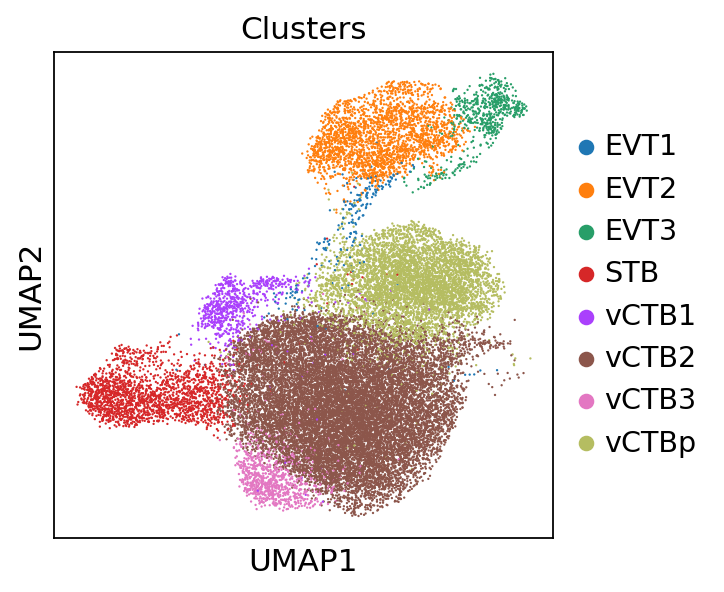

In [18]:
# plot embedding
sc.pl.umap(adata_tro, color='Clusters')#, dpi=100, legend_loc='right margin')

In [19]:
# subset
adata_tro = adata_tro[rna.index.intersection(adata_tro.obs_names), \
dorcs.columns.intersection(adata_tro.var_names).intersection(rna.columns)].copy()
adata_tro

/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


AnnData object with n_obs × n_vars = 27458 × 1017
    obs: 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Gex_nUMI', 'Gex_nGenes', 'Gex_MitoRatio', 'Gex_RiboRatio', 'DoubletScore', 'DoubletEnrichment', 'gest_week', 'Clusters', 'ReadsInPeaks', 'FRIP', 'n_counts', 'FOXF1_dorc', 'C12orf75_dorc', 'ATP11A_dorc', 'RUNX1_dorc', 'GRHL1_dorc', 'IRX2_dorc', 'PLXNB2_dorc', 'KANK1_dorc', 'TCF21_dorc', 'SNAI2_dorc', 'EGFR_dorc', 'HLA-G_dorc', 'VGLL3_dorc', 'FOXI3_dorc', 'PITX1_dorc', 'FLI1_dorc', 'DIO2_dorc', 'PECAM1_dorc', 'KLF6_dorc', 'RTL1_dorc', 'QSOX1_dorc', 'TBX5_dorc', 'ANXA1_dorc', 'TFAP2C_dorc', 'COL6A3_dorc', 'MYCN_dorc', 'ASCL2_dorc', 'CYP19A1_dorc', 'PARD6B_dorc', 'RASGRF2_dorc', 'NFIX_dorc', 'MEG3_dorc', 'MEG8_dorc', 'JAK1_dorc', 'DLK1_dorc', 'NR2F6_dorc', 'CXCL14_dorc'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_co

In [20]:
def normalize(data: pd.DataFrame, axis=0):
    from scipy.stats import zscore
    return zscore(data, axis=axis)

In [21]:
# define the "velocity"
rz = normalize(rna.loc[:,adata_tro.var_names], axis=0)
dz = normalize(dorcs.loc[:,adata_tro.var_names], axis=0)

diff = rz.loc[adata_tro.obs_names] - dz.loc[adata_tro.obs_names]
adata_tro.layers['velocity'] = diff.values

In [23]:
k = cr.kernels.VelocityKernel(adata_tro)
k.compute_transition_matrix(model='deterministic', softmax_scale=None)  # estimate softmax scale

100%|█████████████████████████████████████████| 27458/27458 [00:30<00:00, 902.25cell/s]


VelocityKernel[n=27458, model='deterministic', similarity='correlation', softmax_scale=26.32]

/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/k

figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file ./figures/scvelo__umap_chrompotential_tropho.png


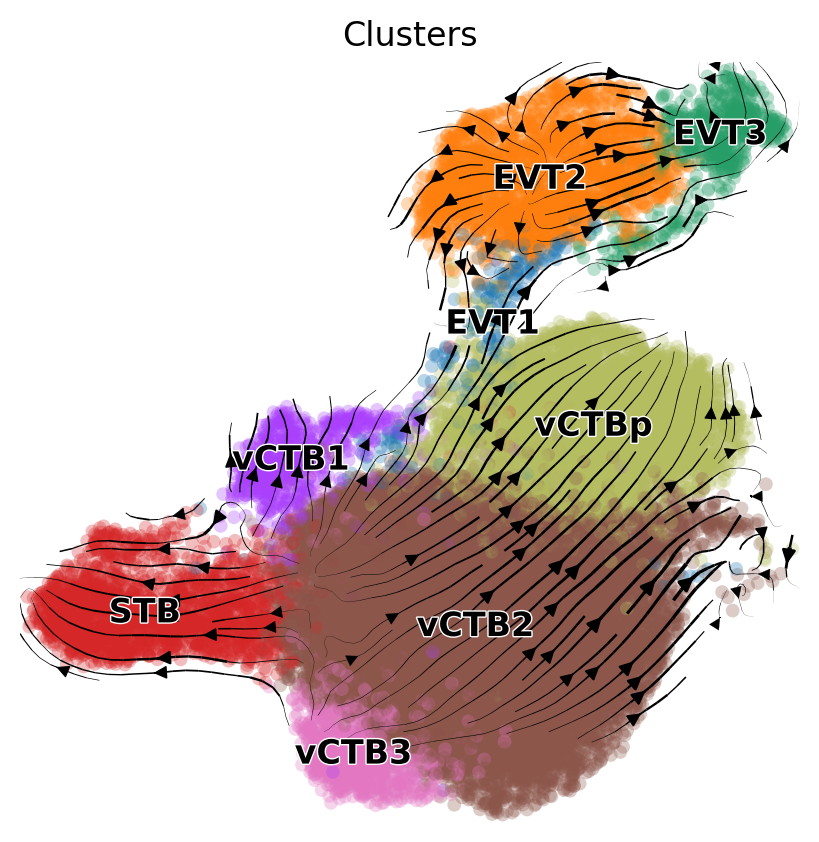

In [24]:
scv.set_figure_params()
k.plot_projection(basis='umap', figsize=(5,5), color='Clusters', save='_umap_chrompotential_tropho.pdf')

100%|███████████████████████████████████████████████| 100/100 [00:02<00:00, 42.88sim/s]
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) i

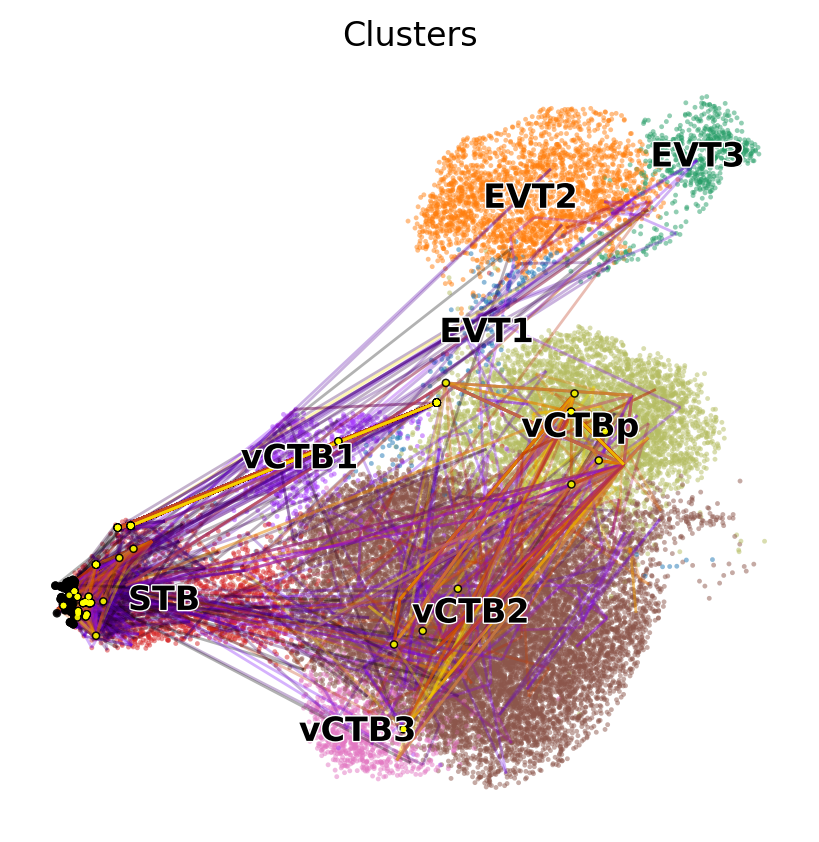

In [25]:
# plot random walks
start_ixs = adata.obs_names[np.argsort(adata.obsm['X_umap'][:, 0])[:50]]

k.plot_random_walks(100, start_ixs=start_ixs, max_iter=50, dpi=100,
                    alpha=0.5, basis='umap', color='Clusters', seed=0, figsize=(5,5))

In [26]:
g = cr.estimators.GPCCA(k)
g.compute_schur()

GPCCA[kernel=VelocityKernel[n=27458], initial_states=None, terminal_states=None]

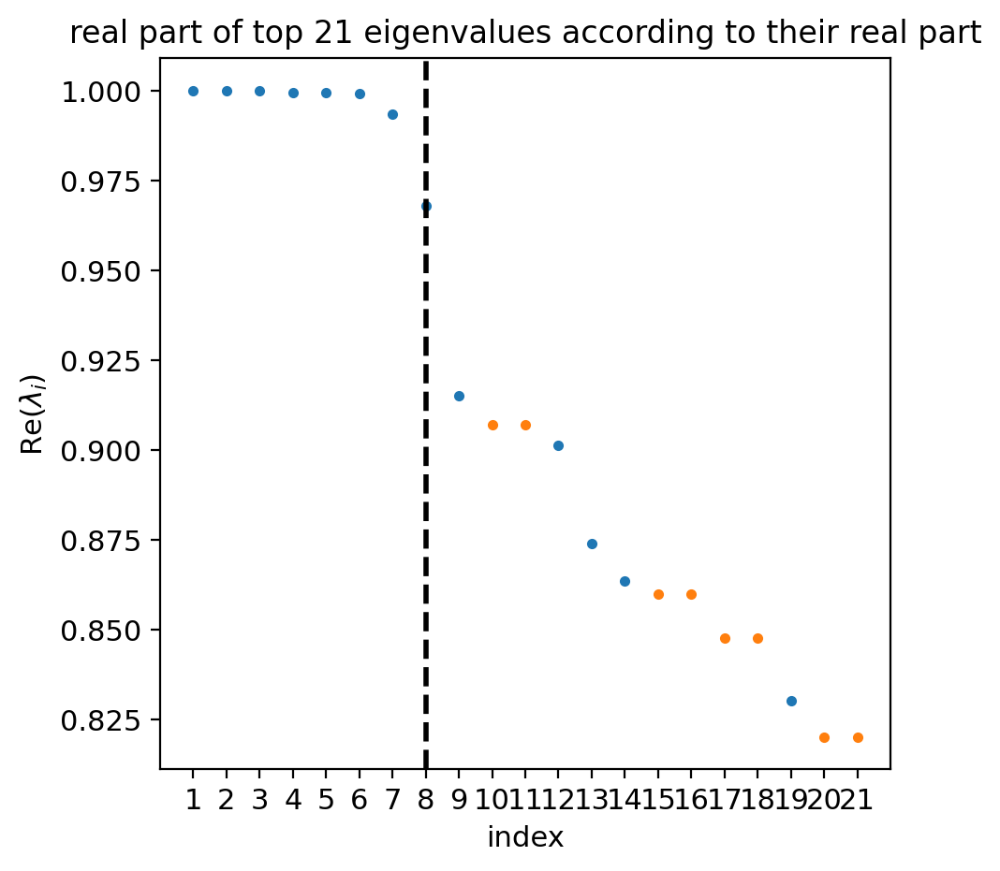

In [27]:
g.plot_spectrum(real_only=True)

In [44]:
# macrostates
g.compute_macrostates(cluster_key='Clusters', n_states=21)

GPCCA[kernel=VelocityKernel[n=27458], initial_states=None, terminal_states=None]

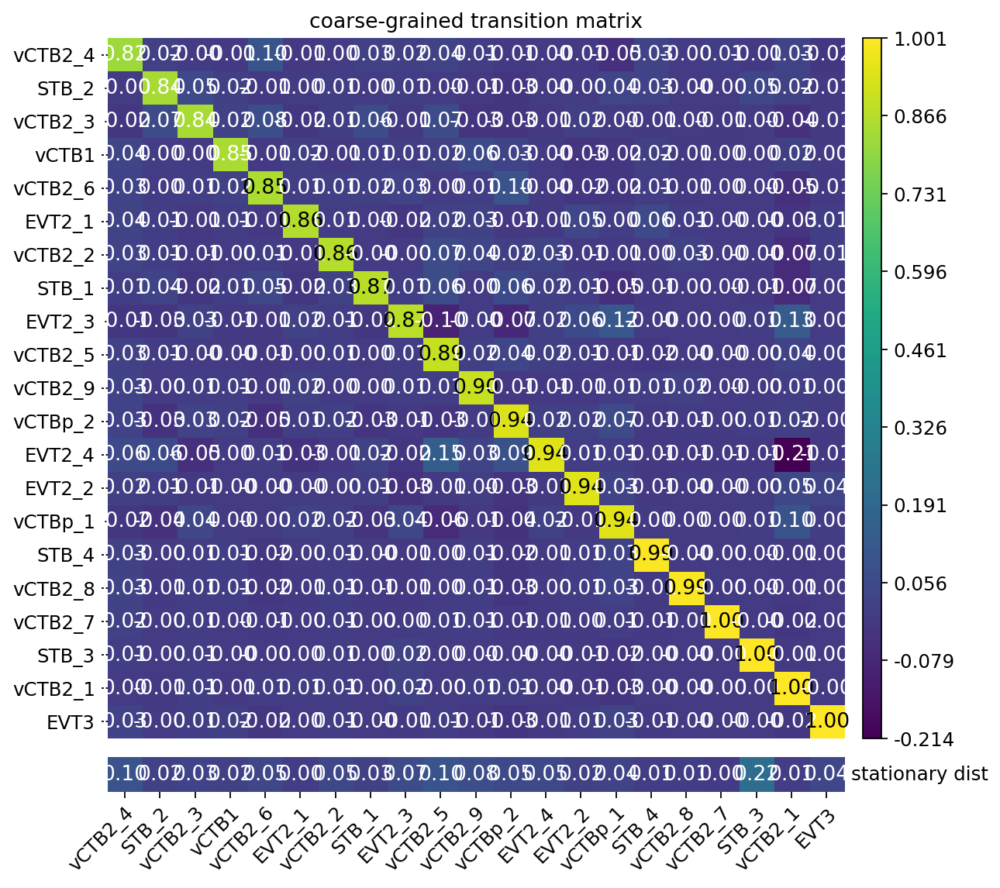

In [29]:
g.plot_coarse_T()

In [97]:
scv.set_figure_params(figsize=(3,3))

In [98]:
g.predict_initial_states(n_states=2, allow_overlap=True)

GPCCA[kernel=VelocityKernel[n=27458], initial_states=['EVT2_1', 'vCTB2_7'], terminal_states=['EVT3', 'STB_3', 'vCTB2_1']]

/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/k

saving figure to file ./figures/scvelo_initial_states_n2.pdf


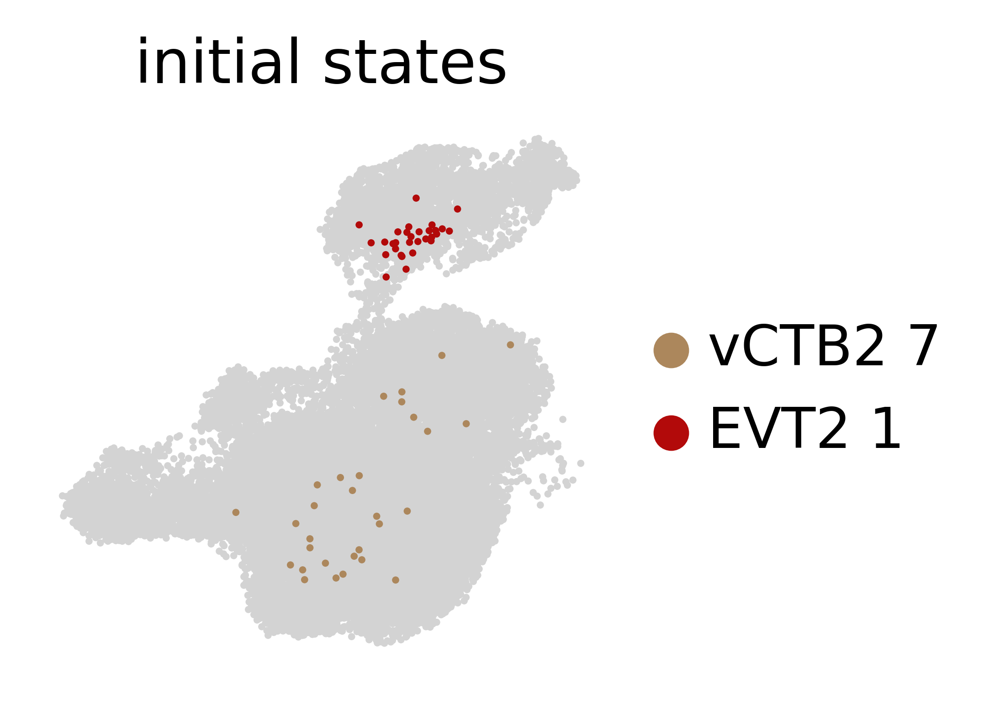

In [108]:
# plt.grid(None)
g.plot_macrostates(which="initial", legend_loc="right", save='initial_states_n2.pdf', dpi=400, figsize=(2,2), size=8)

/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/kkobayashi_kirschvink/miniconda3/envs/cellrank/lib/python3.9/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/k

saving figure to file ./figures/scvelo_terminalstates_umap_n3.pdf


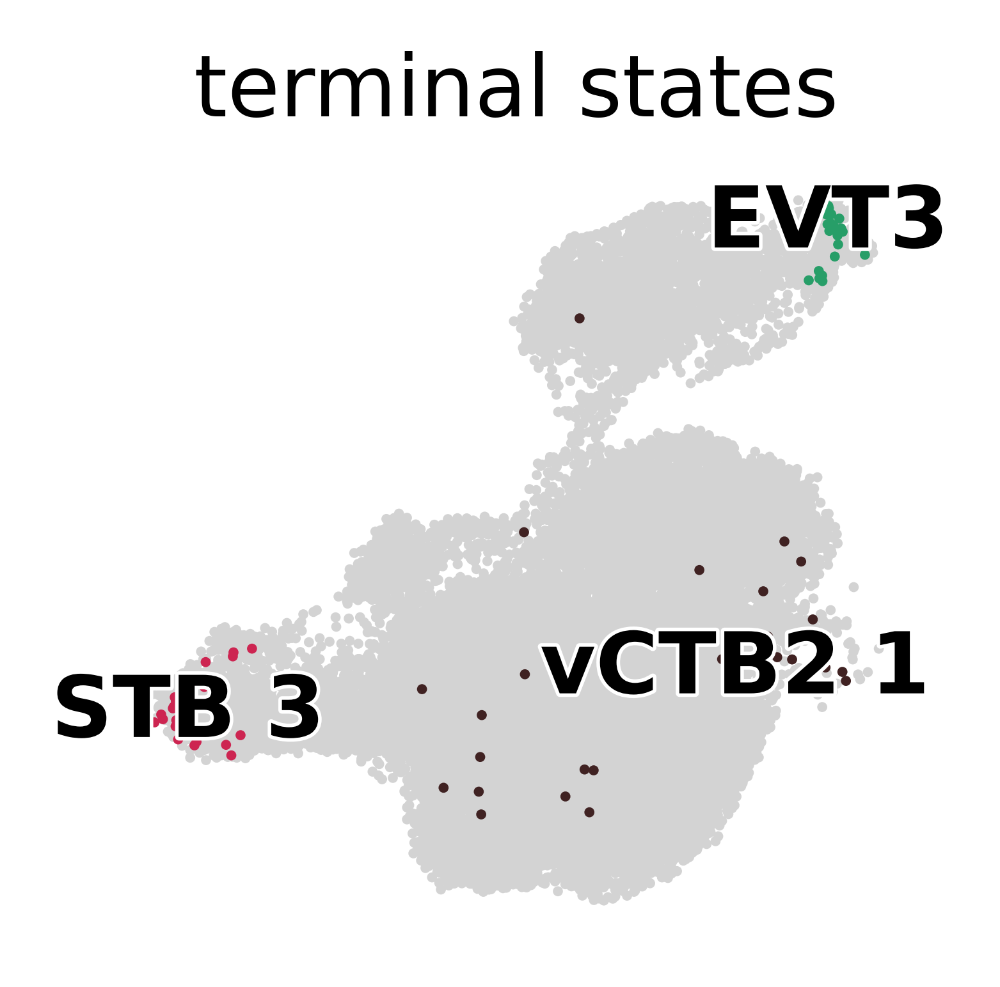

In [109]:
g.predict_terminal_states(method="top_n", n_states=3, allow_overlap=True)
g.plot_macrostates(which="terminal", save='terminalstates_umap_n3.pdf', dpi=400, figsize=(2,2), size=8)

In [ ]:
g.compute_fate_probabilities(solver='direct')

saving figure to file ./figures/scvelo_transitionprob_umap.pdf


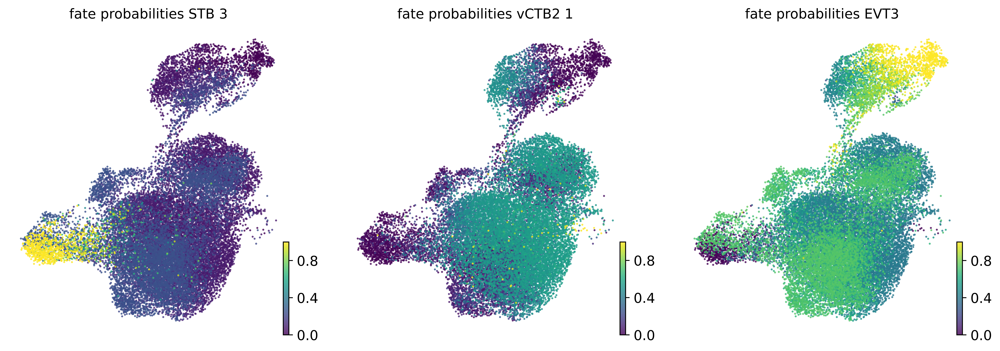

In [67]:
g.plot_fate_probabilities(dpi=400, same_plot=False, alpha=0.8, basis='umap', figsize=(5,5), save='transitionprob_umap.pdf')

In [ ]:
r = g.compute_lineage_drivers(layer='X', use_raw=True)
r.head(20)

In [75]:
r.head(20)

,STB_3_corr,STB_3_pval,STB_3_qval,STB_3_ci_low,STB_3_ci_high,vCTB2_1_corr,vCTB2_1_pval,vCTB2_1_qval,vCTB2_1_ci_low,vCTB2_1_ci_high,EVT3_corr,EVT3_pval,EVT3_qval,EVT3_ci_low,EVT3_ci_high
Gene,,,,,,,,,,,,,,,
CGA,0.782370,0.000000e+00,0.000000e+00,0.777739,0.786916,-0.206018,8.381145e-263,3.409450e-261,-0.217316,-0.194664,-0.492218,0.000000e+00,0.000000e+00,-0.501129,-0.483203
CYP19A1,0.610462,0.000000e+00,0.000000e+00,0.602988,0.617829,-0.203365,6.073481e-256,2.287678e-254,-0.214677,-0.191999,-0.334468,0.000000e+00,0.000000e+00,-0.344931,-0.323921
KRT23,0.466513,0.000000e+00,0.000000e+00,0.457208,0.475717,-0.024826,3.881819e-05,8.911534e-05,-0.036643,-0.013002,-0.407579,0.000000e+00,0.000000e+00,-0.417395,-0.397668
ANXA1,0.356066,0.000000e+00,0.000000e+00,0.345694,0.366351,-0.060566,9.386088e-24,4.223740e-23,-0.072343,-0.048773,-0.262648,0.000000e+00,0.000000e+00,-0.273626,-0.251602
MALAT1,0.276477,0.000000e+00,0.000000e+00,0.265517,0.287366,-0.578438,0.000000e+00,0.000000e+00,-0.586255,-0.570513,0.414533,0.000000e+00,0.000000e+00,0.404690,0.424281
SLC13A4,0.247348,0.000000e+00,0.000000e+00,0.236211,0.258420,-0.137299,5.278006e-116,7.893723e-115,-0.148886,-0.125675,-0.071627,1.357185e-32,6.449801e-32,-0.083384,-0.059849
CYP11A1,0.241699,0.000000e+00,0.000000e+00,0.230530,0.252804,-0.120287,3.143073e-89,3.716866e-88,-0.131927,-0.108613,-0.086140,1.935561e-46,1.075664e-45,-0.097869,-0.074388
PRKCZ,0.239073,0.000000e+00,0.000000e+00,0.227889,0.250193,-0.224943,0.000000e+00,0.000000e+00,-0.236143,-0.213683,0.038119,2.627735e-10,7.701460e-10,0.026303,0.049925
SLC22A11,0.238367,0.000000e+00,0.000000e+00,0.227179,0.249492,-0.107769,7.332087e-72,7.034654e-71,-0.119445,-0.096063,-0.097592,3.512416e-59,2.365647e-58,-0.109294,-0.085863


In [76]:
r.to_csv('figures/lineage_drivers.tsv', sep='\t')

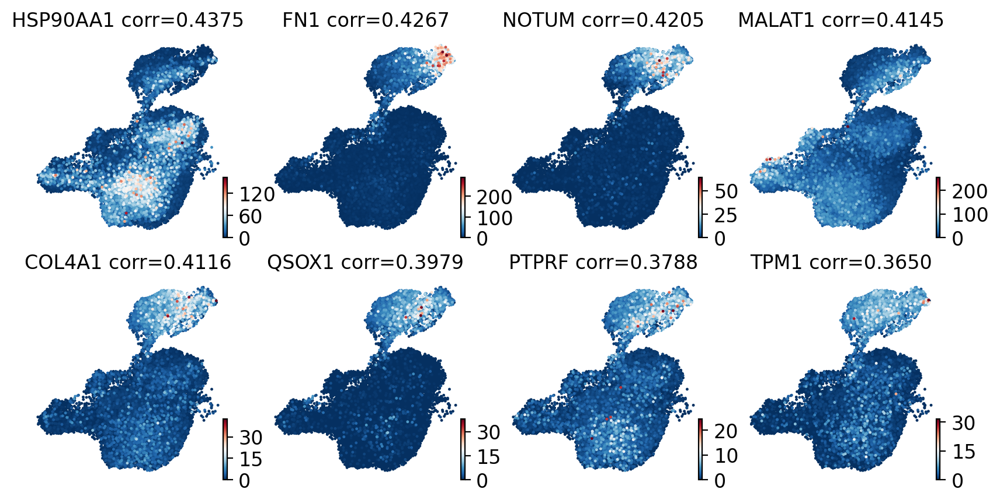

In [72]:
g.plot_lineage_drivers("EVT3", use_raw=False, basis='umap',
                       title_fmt="{gene} corr={corr:.4f}", save='lineagedrivers_umap_EVT3.pdf', figsize=(10,5))

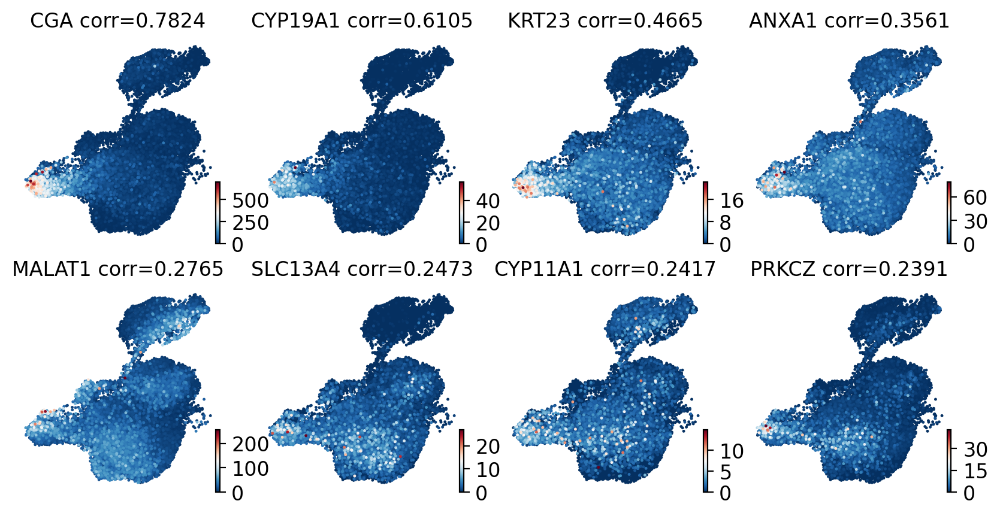

In [73]:
g.plot_lineage_drivers("STB_3", use_raw=False, basis='umap',
                       title_fmt="{gene} corr={corr:.4f}", save='lineagedrivers_umap_STB_3.pdf', figsize=(10,5))

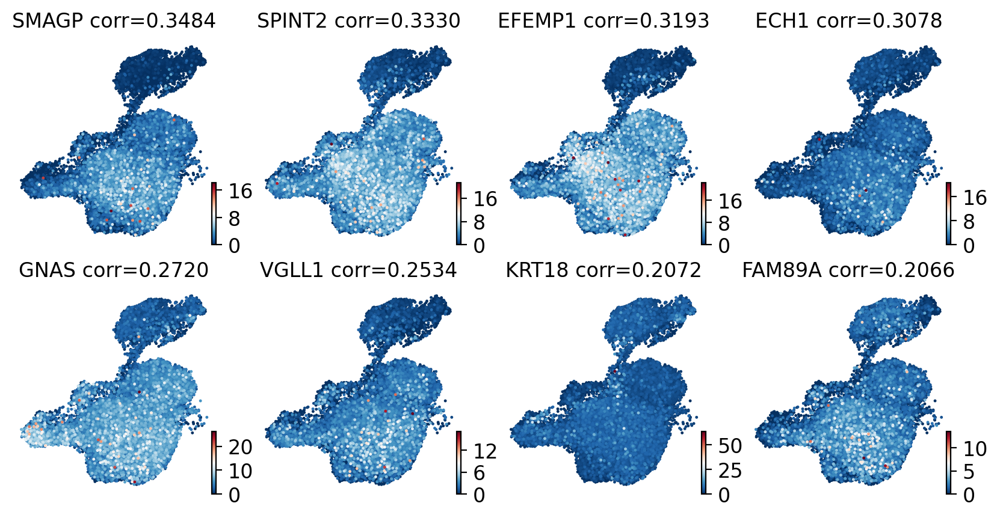

In [74]:
g.plot_lineage_drivers("vCTB2_1", use_raw=False, basis='umap',
                       title_fmt="{gene} corr={corr:.4f}", save='lineagedrivers_umap_vCTB2_1.pdf', figsize=(10,5))